### Introduction to Nonlinear Dynamics HW3: Pratik Aghor
### Dynamics of the Henon map and Rossler flow

In [140]:
using Plots, LinearAlgebra

In [141]:
function henon_f(a,b)
    function f(x)
        [1 + x[2] - a*x[1]*x[1]; b*x[1]]
    end
    return f
end

function henon_Df(a,b)
    function Df(x)
        [-2*a*x[1] 1; b 0]
    end
    return Df
end

function henon_finv(a,b)
    function finv(x)
        [x[2]/b; x[1] - 1 + a*(x[2]/b)^2]
    end
    return finv
end

function henon_Dfinv(a,b)
    function Dfinv(x)
        [0 1/b; 1 2*a*x[2]/(b*b)]
    end
    return Dfinv
end

function eigensort(A)
    Lambda, V = eigen(A)
    s,u = abs(Lambda[1]) < 1 ? (1,2) : (2,1) 
    return Lambda[s], Lambda[u], V[:,s], V[:,u]
end

function linesegment(P,Q, N=100)
    PQ = zeros(N,length(P))
    c = range(0, 1, length=N)
    for n=1:N
        PQ[n,:] = c[n]*P + (1-c[n])*Q
    end
    PQ
end

function fnX!(X, f, n)
    fX = copy(X)
    for k=1:n
        fX = mapslices(f,fX,dims=2)
    end
    #fX = trim(fX)
    fX
end

function plotfnX!(X, f, n; label="", color=:black, linestyle=:solid, width=1)
    fX = copy(X)
    for k=1:n
        fX = mapslices(f,fX,dims=2)
    end
    plot!(fX[:,1], fX[:,2], label=label, color=color, linestyle=linestyle, linewidth=width)
end

plotfnX! (generic function with 1 method)

## Q1: Homoclinic Orbit of Henon Map

In [142]:
# iterate f n times, given an initial condition x0
function fIter(f, x0, nIter)
    xt = zeros(nIter+1, 2)
    for i = 1:nIter+1
        xt[i, 1] = x0[1]
        xt[i, 2] = x0[2]
        # update for iteration
        x0 .= f(x0)
    end
    return xt
end

fIter (generic function with 1 method)

In [143]:
a,b = 1.4, 0.3

x0 = [0.; 0.]
N = 20001
t₀ = 0.0

f  = henon_f(a,b)

xt = fIter(f, x0, N)

# fp's of Henon map, p for plus, m for minus
xstar_p = (b - 1 + sqrt((1-b)^2 + 4*a))/(2*a)
ystar_p = b*xstar_p
xstar_m = (b - 1 - sqrt((1-b)^2 + 4*a))/(2*a)
ystar_m = b*xstar_m

-0.3394063431268514

In [144]:
# plot Henon map and equilibria
scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([xstar_p], [ystar_p], markercolor=:green, label="fp1")
scatter!([xstar_m], [ystar_m], markercolor=:yellow, label="fp2")
plot!(xlim=(-1.3,1.3), ylim=(-0.4,0.4))
plot!(xlabel="x",ylabel="y")
plot!(legend=:topleft)
plot!(title="Henon map")

In [145]:
fp1 = [xstar_p, ystar_p]
fp2 = [xstar_m, ystar_m]
@show xstar_p, ystar_p
@show fp1

(xstar_p, ystar_p) = (0.6313544770895047, 0.1894063431268514)
fp1 = [0.631354, 0.189406]


2-element Array{Float64,1}:
 0.6313544770895047
 0.1894063431268514

In [146]:
Df = henon_Df(a, b)
Df_fp1 = Df(fp1)

lambdas, lambdau, vs, vu = eigensort(Df_fp1)

(0.15594632230279395, -1.9237388581534067, [-0.461228, -0.887282], [-0.988058, 0.154084])

In [147]:
r=0.4
Svec = linesegment(fp1 + (r/10)*vs, fp1 - (r/10)*vs, 2)
Uvec = linesegment(fp1 + r*vu, fp1 - r*vu, 2)

w0 = 1  # linewidths for fp0 and fp1 unstable manifolds
w1 = 2

scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")

plotfnX!(Svec, f, 0, label="stable", color=:blue, width=w1)
plotfnX!(Uvec, f, 0, label="unstable", color=:red, width=w1)

plot!(xlabel="x", ylabel="y", title="")
plot!(legend=:bottomleft)

plot!(title="Stable & unstable eigvecs of Henon map fixed pt")

#### Estimate unstable manifold through forward iterations of unstable eigvec
* Fwd(Bkd) iterates of unstable(stable) eigvec approx unstable(stable) manifold

In [148]:
r=0.001
Svec = linesegment(fp1 + (r/100)*vs, fp1, 100)
Uvec = linesegment(fp1 + r*vu, fp1 - r*vu, 100)

n = 14
ninv = 7
finv  = henon_finv(a,b)

scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")

plotfnX!(Uvec, f, n, label="U", color=:red, width=w1)
plotfnX!(Svec, finv, ninv, label="S", color=:blue, width=w1)


plot!(xlabel="x", ylabel="y", title="")
plot!(legend=:bottomleft)
plot!(xlim=(-1.3,1.3), ylim=(-0.6,0.4))

plot!(title="Fwd(Bkd) iters of unstable(stable) eigvec approx unstable(stable) mfld")

### Guess homoclinic point xhomo:

In [149]:
scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")

plotfnX!(Uvec, f, n, label="U", color=:red, width=w1)
plotfnX!(Svec, finv, ninv, label="S", color=:blue, width=w1)



r0 = 1.074e-05
x0 = fp1 + r0*vu

N = 20
Ninv = 0

Ntot = N + Ninv
xtraj = zeros(Ntot,2)
xtraj[1,:] .= x0

for n=1:Ntot-1
    xtraj[n+1,:] .= f(xtraj[n,:])
end
scatter!(xtraj[:,1], xtraj[:,2], markershape=:circ, label="xtraj", color=:yellow)
scatter!([xtraj[end,1]], [xtraj[end,2]], markershape=:circ, label="", color=:indigo)
    
plot!(xlabel="x", ylabel="y", title="")
plot!(legend=:topright)
plot!(xlim=(-1.3,1.3), ylim=(-0.6,0.4))
plot!(title="trying to hit xhomo from an unstable perturbation of xstar")

In [150]:
xhomoguess = xtraj[end,:]

2-element Array{Float64,1}:
  0.338692916555964 
 -0.2551334565987987

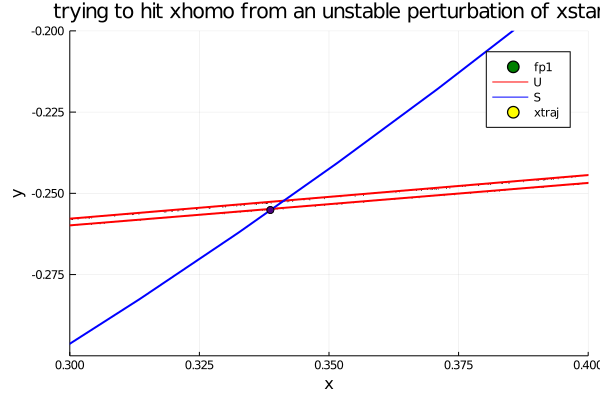

In [151]:
scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")

plotfnX!(Uvec, f, n, label="U", color=:red, width=w1)
plotfnX!(Svec, finv, ninv, label="S", color=:blue, width=w1)

scatter!(xtraj[:,1], xtraj[:,2], markershape=:circ, label="xtraj", color=:yellow)
scatter!([xtraj[end,1]], [xtraj[end,2]], markershape=:circ, label="", color=:indigo)
    
plot!(xlabel="x", ylabel="y", title="")
plot!(legend=:topright)
plot!(xlim=(0.3,0.4), ylim=(-0.3,-0.2))
plot!(title="trying to hit xhomo from an unstable perturbation of xstar")


### Local polynomial interpolation of unstable manifold, near homoclinic guess


In [152]:
umfld = fnX!(Uvec, f, n); # unstable manifold

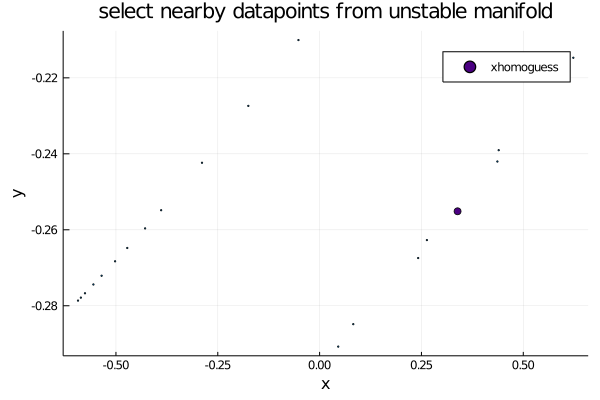

In [153]:
idx = findall(y -> -0.3 < y < -0.2, umfld[:, 2])

scatter(umfld[idx,1], umfld[idx,2], markersize=1, label="")
scatter!([xhomoguess[1]], [xhomoguess[2]], markershape=:circ, label="xhomoguess", color=:indigo)

plot!(xlabel="x", ylabel="y", title="")
plot!(title="select nearby datapoints from unstable manifold")

#### We cannot fit a polynomial yet as the points do not fall in one sequence to making it a multi-valued function. First, we sort the points according to their radial distance from the origin. 

In [154]:
coarse_nbhd = umfld[idx,:]
coarse_nbhd = vcat(coarse_nbhd, transpose(xhomoguess))

21×2 Array{Float64,2}:
  0.606559   -0.214071
  0.439646   -0.239047
  0.263397   -0.262713
  0.0826641  -0.284846
  0.0457314  -0.290752
  0.24199    -0.267439
  0.436462   -0.242026
  0.622894   -0.214706
 -0.0519385  -0.210054
 -0.174972   -0.227381
 -0.288731   -0.242351
 -0.389012   -0.254851
 -0.472167   -0.264788
 -0.535229   -0.272092
 -0.575999   -0.276717
 -0.593119   -0.278639
 -0.586105   -0.277859
 -0.55535    -0.274398
 -0.502106   -0.268301
 -0.42842    -0.259637
  0.338693   -0.255133

In [155]:
idx = sortperm(coarse_nbhd[:, 1])
nbhd = coarse_nbhd[idx, :]

21×2 Array{Float64,2}:
 -0.593119   -0.278639
 -0.586105   -0.277859
 -0.575999   -0.276717
 -0.55535    -0.274398
 -0.535229   -0.272092
 -0.502106   -0.268301
 -0.472167   -0.264788
 -0.42842    -0.259637
 -0.389012   -0.254851
 -0.288731   -0.242351
 -0.174972   -0.227381
 -0.0519385  -0.210054
  0.0457314  -0.290752
  0.0826641  -0.284846
  0.24199    -0.267439
  0.263397   -0.262713
  0.338693   -0.255133
  0.436462   -0.242026
  0.439646   -0.239047
  0.606559   -0.214071
  0.622894   -0.214706

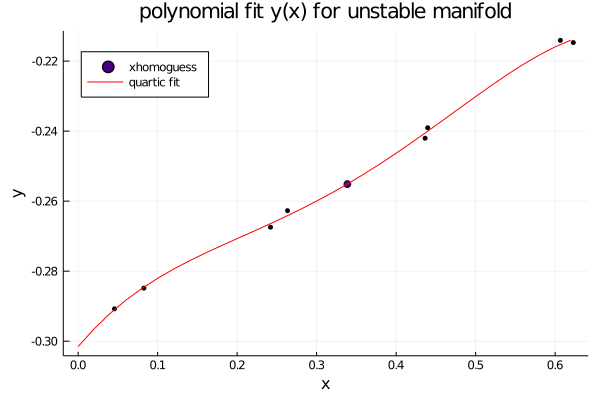

In [156]:
# fit a 4th order polynomial for y = nbhd[1:6, 2] as a function of x = nbhd[1:6, 1]
using Polynomials

y = fit(nbhd[13:end, 1], nbhd[13:end, 2], 4)
x = 0.:0.02:0.63

scatter(nbhd[13:end, 1], nbhd[13:end, 2], markersize=3, label="", markercolor=:black)
scatter!([xhomoguess[1]], [xhomoguess[2]], markershape=:circ, label="xhomoguess", color=:indigo)

plot!(x, y.(x), width=1, color=:red, label="quartic fit")
plot!(xlabel="x", ylabel="y", title="")
plot!(legend=:topleft)
plot!(title="polynomial fit y(x) for unstable manifold")


### Select the points on that are near the guess for the homocliic point.


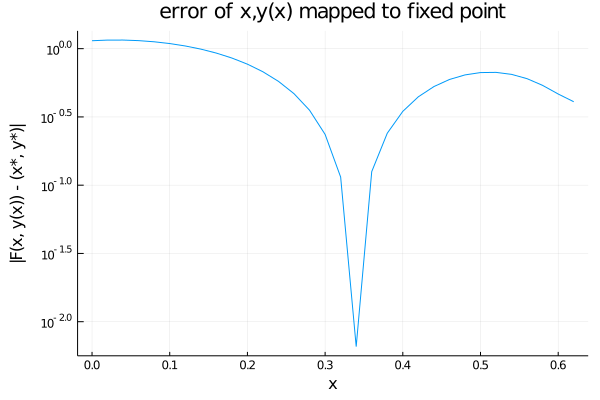

In [157]:
dist = x -> norm(f(f(f(f([x, y(x)])))) - fp1)

x = 0.:0.02:0.63
plot(x, dist.(x), yaxis=:log, label="")
plot!(xlabel="x", ylabel="|F(x, y(x)) - (x*, y*)|")
plot!(title="error of x,y(x) mapped to fixed point")

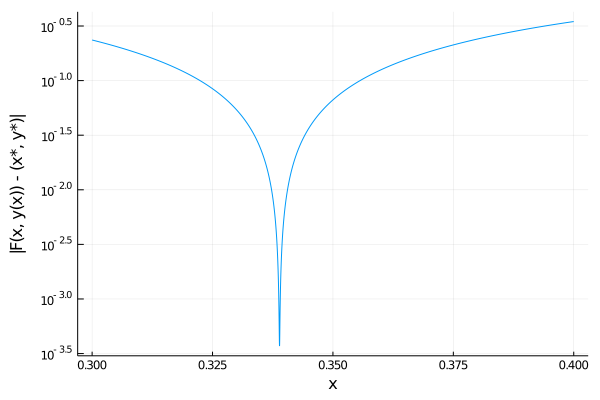

In [158]:
x = 0.3:0.00001:0.4
plot(x, dist.(x), yaxis=:log, label="")
plot!(xlabel="x", ylabel="|F(x, y(x)) - (x*, y*)|")

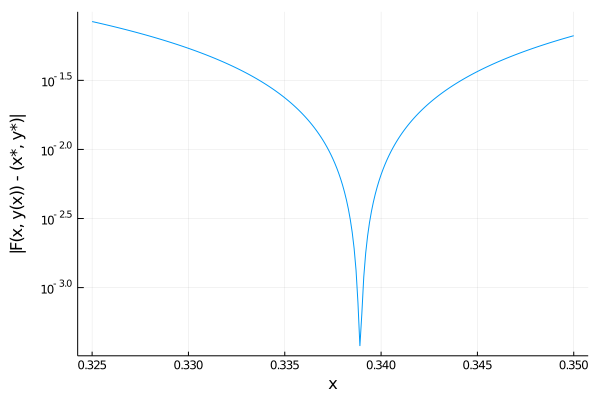

In [159]:
x = 0.325:0.0001:0.35
plot(x, dist.(x), yaxis=:log, label="")
plot!(xlabel="x", ylabel="|F(x, y(x)) - (x*, y*)|")

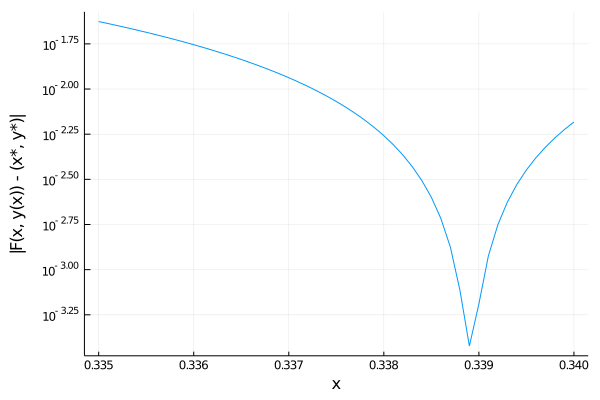

In [160]:
x = 0.335:0.0001:0.34
plot(x, dist.(x), yaxis=:log, label="")
plot!(xlabel="x", ylabel="|F(x, y(x)) - (x*, y*)|")

In [161]:
(mindist,i) = findmin(dist.(x))

@show mindist
x[i]

mindist = 0.000377523546704225


0.3389

In [162]:
xhomo = [x[i], y(x[i])]

2-element Array{Float64,1}:
  0.3389             
 -0.25506791028083037

In [163]:
@show xhomo
@show f(f(f(f(xhomo)))) - fp1
@show f(f(f(f(f(xhomo))))) - fp1

xhomo = [0.3389, -0.255068]
f(f(f(f(xhomo)))) - fp1 = [-0.000130201, -0.000354361]
f(f(f(f(f(xhomo))))) - fp1 = [-0.000124216, -3.90603e-5]


2-element Array{Float64,1}:
 -0.0001242161274240816
 -3.906033701051026e-5 

In [164]:
scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")
scatter!([xhomo[1]], [xhomo[2]], markershape=:circ, color=:red, label="xhomo")

plot!(xlabel="x", ylabel="y", title="")
# plot!(legend=:topright)
# plot!(xlim=(0.5,0.7), ylim=(0.05,0.25))
plot!(title="Fixed point and homoclinic intersection henon map")

### Refine homoclinic orbit by chaning r0

In [165]:

# r0 = 1.07393e-05
# x0 = fp1 + r0*vu

# N = 24
# Ninv = 0

# Ntot = N + Ninv
# xtraj = zeros(Ntot,2)
# xtraj[1,:] .= x0

# for n=1:Ntot-1
#     xtraj[n+1,:] .= f(xtraj[n,:])
# end
# mapslices(x -> norm(x-fp1), xtraj, dims=2)

In [166]:
N = 25
Ninv = 0

Ntot = N + Ninv
xtraj = zeros(Ntot,2)
xtraj[1,:] .= xhomo

for n=1:Ntot-1
    xtraj[n+1,:] .= f(xtraj[n,:])
end
mapslices(x -> norm(x-fp1), xtraj, dims=2)

25×1 Array{Float64,2}:
 0.532059191361273     
 0.09963483222052869   
 0.01597592306821118   
 0.002511481075839578  
 0.000377523546704225  
 0.00013021273455238668
 0.00018431285953344272
 0.0003604987197667909 
 0.0006923362995587455 
 0.0013326946711384674 
 0.002561260306870172  
 0.004936331722188845  
 0.00946229438561888   
 0.018327631296129004  
 0.03479008625021275   
 0.06861250519807913   
 0.12544441329225395   
 0.2632556732842513    
 0.4102873542304751    
 1.0244604257989856    
 0.560677283757077     
 1.453219196085864     
 0.491450690656101     
 0.12205375939049844   
 0.09903116904008571   

# Constructing crude homoclinic orbit

In [167]:
# scatter()
# scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
# scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")
# scatter!([xhomo[1]], [xhomo[2]], markershape=:circ, color=:red, label="xhomo")

# n0 = 20
# for n=n0:n0+10
#     plot!(xt[n:n+1,1], xt[n:n+1,2], label="")
# end
# scatter!([xt[n0,1]], [xt[n0,2]], markercolor=:blue, label="x0")
# plot!(xlabel="y", ylabel="z", title="")
# # plot!(xlim=(9,19), ylim=(0,0.045))
# plot!(legend=:bottomleft)
# plot!(title="a ten-step trajectory of Henon map")

In [168]:
scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")
scatter!([xhomo[1]], [xhomo[2]], markershape=:circ, color=:red, label="xhomo")
scatter!(xtraj[:,1], xtraj[:,2], markershape=:circ, label="xtraj", color=:blue)
plotfnX!(Uvec, f, n, label="U", color=:red, width=w1)
plotfnX!(Svec, finv, ninv, label="S", color=:blue, width=w1)

# plot xtraj, the homoclinic trajectory
for n=1:24
    plot!(xtraj[n:n+1,1], xtraj[n:n+1,2], label="", width=2) 
end

plot!(xlabel="x", ylabel="y", title="")
plot!(xlim=(-1.3,1.3), ylim=(-0.6,0.4))
plot!(legend=:bottomright)
plot!(title="homoclinic trajectory of Henon map")

## Q4: Challenge: Compute enough of the stable and unstable manifolds of the Henon fixed point to show that they intersect at every point on the homoclinic trajectory 

(but not of course after the inaccuracy of computed homoclinic orbit causes to to diverge from the fixed point where it should converge). 

In [169]:
r=0.001
Svec = linesegment(fp1 + (r/100)*vs, fp1, 5000)
Uvec = linesegment(fp1 + r*vu, fp1 - r*vu, 1000)

n = 15
ninv = 10
scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")
scatter!([xhomo[1]], [xhomo[2]], markershape=:circ, color=:red, label="xhomo")
scatter!(xtraj[:,1], xtraj[:,2], markershape=:circ, label="xtraj", color=:blue)
plotfnX!(Uvec, f, n, label="U", color=:red, width=w1)
plotfnX!(Svec, finv, ninv, label="S", color=:blue, width=w1)

# plot xtraj, the homoclinic trajectory
for n=1:24
    plot!(xtraj[n:n+1,1], xtraj[n:n+1,2], label="", width=2) 
end

plot!(xlabel="x", ylabel="y", title="")
plot!(xlim=(-1.3,1.3), ylim=(-0.6,0.4))
plot!(legend=:bottomright)
plot!(title="homoclinic trajectory of Henon map")

## Q5 Challenge squared: Calculate more accurate stable and unstable manifolds of the Henon fixed point than showed in lecture by fitting them as quadratic curves in the neighborhood of the fixed point. As in lecture, do this for the fixed point embedded in the attractor.

fp1 = [0.631354, 0.189406]


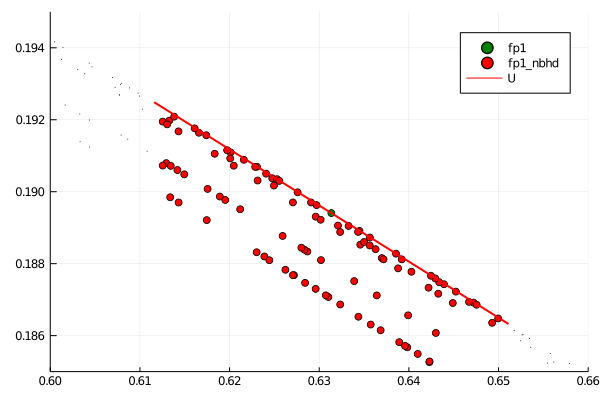

In [256]:
# first extract points in the eps-ball around fp1
eps = 2e-2
imax = size(xt)[1]
diff = zeros(imax)
for i = 1:imax
    diff[i] = norm(xt[i, :] - fp1)
end

# idx = findall(y -> fp1[2]-eps < y < fp1[2]+eps, xt[:, 2])
idx = findall(x -> 0 < x < eps, diff)
@show fp1
fp1_nbhd = xt[idx, :]

len_nbhd = size(fp1_nbhd)[1]

r=0.02
Svec = linesegment(fp1 + (r/100)*vs, fp1, len_nbhd)
Uvec = linesegment(fp1 + r*vu, fp1 - r*vu, len_nbhd)

scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")
scatter!(fp1_nbhd[:,1], fp1_nbhd[:,2], markershape=:circ, label="fp1_nbhd", color=:red)
plotfnX!(Uvec, f, 0, label="U", color=:red, width=w1)

plot!(xlim=(0.6,0.66), ylim=(0.185,0.195))


In [260]:
# select the relevant branch
function vec_dist(x, vec)
    vec_len = size(vec)[1]
    dist_array = zeros(vec_len)
    for i = 1:vec_len
        dist_array[i] = norm(vec[i, :]-x)
    end
    return minimum(dist_array)
end        

vec_dist (generic function with 1 method)

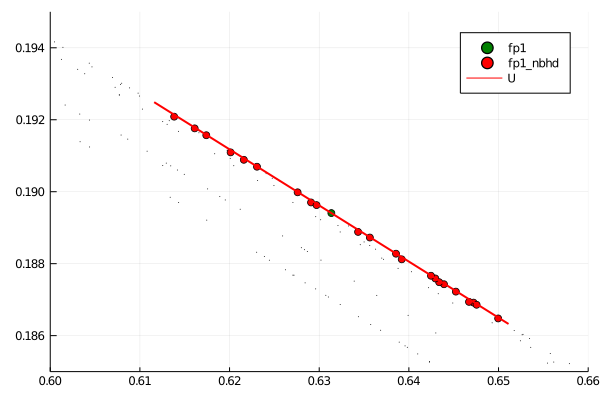

In [268]:
fp1_nbhd_2 = []
dist_array = zeros(len_nbhd)
for i=1:len_nbhd
    dist_array[i] = vec_dist(fp1_nbhd[i, :], Uvec)
end
idx = findall(x -> 0 < x < 1e-4, dist_array)
fp1_nbhd_2 = fp1_nbhd[idx, :]

scatter()
scatter!(xt[:,1], xt[:,2], markersize=0.1, color=:black, label="")
scatter!([fp1[1]], [fp1[2]], markershape=:circ, color=:green, label="fp1")
scatter!(fp1_nbhd_2[:,1], fp1_nbhd_2[:,2], markershape=:circ, label="fp1_nbhd", color=:red)
plotfnX!(Uvec, f, 0, label="U", color=:red, width=w1)

plot!(xlim=(0.6,0.66), ylim=(0.185,0.195))


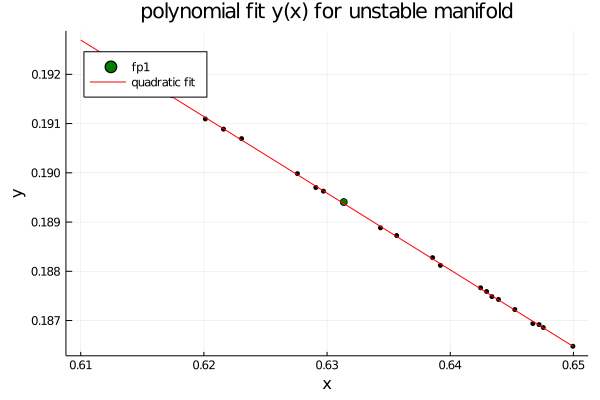

In [273]:
y = fit(fp1_nbhd_2[:, 1], fp1_nbhd_2[:, 2], 3)
x = 0.61:0.02:0.65
scatter(fp1_nbhd_2[:, 1], fp1_nbhd_2[:, 2], markersize=3, label="", markercolor=:black)
scatter!([fp1[1]], [fp1[2]], markershape=:circ, label="fp1", color=:green)

plot!(x, y.(x), width=1, color=:red, label="quadratic fit")
plot!(xlabel="x", ylabel="y", title="")
plot!(legend=:topleft)
plot!(title="polynomial fit y(x) for unstable manifold")

#### This looks almost exactly a straight line, like the Uvec we have above. So, I don't think it will improve anything while calculating the homoclinic orbit. 

## Q2 Largest Lyapunov Exponent of Henon Map

In [171]:
function get_lambdamax(a, b, x0)
    
    f = henon_f(a, b)
    Df = henon_Df(a, b)
    ndim = 2
    
    n = 5000
    # lambda_j = (1/n) s_j
    s = zeros(ndim) 
    lambda = zeros(ndim)
    
    # initialize Q0
    Q0 = Matrix{Float64}(I, ndim, ndim)
    
    for k = 1:n
        Q, R = qr(Df(x0)*Q0)
        for j = 1:ndim 
            s[j] = s[j] + log(abs(R[j, j]))
        end
        # update x0, Q0
        x0 = f(x0)
        Q0 = Q
    end
    lambda .= s/n
    
    return maximum(lambda)
end

get_lambdamax (generic function with 1 method)

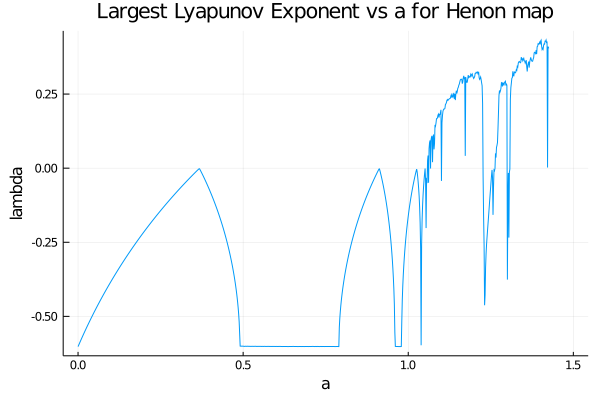

In [172]:
a_vec = range(0, stop=1.5,length=1000)
b = 0.3
lambda_vec = zeros(length(a_vec))
x0 = [0., 0.]

for i=1:length(a_vec)
    a = a_vec[i]
    lambda_vec[i] = get_lambdamax(a, b, x0)
end
plot(a_vec, lambda_vec, markersize=1)
plot!(xlabel="a", ylabel="lambda", title="")
plot!(legend=:false)
plot!(title="Largest Lyapunov Exponent vs a for Henon map")

In [173]:
get_lambdamax(1.4, 0.3, [1., 0.])

0.4252079507360546

# Q3 Periodic Orbits of Rossler System

* Much of the code is a replica of Prof Gibson's Rossler notebook

## 1. Rossler system integration code

In [174]:
function rk4(f, y₀, Δt, N, t₀=0.0) 
   
    # fix up Δt so it evenly divides time interval
    #Δt = (t₁ - t₀)/N
    Δt2 = Δt/2
    Δt6 = Δt/6
    t₁ = t₀ + (N-1)*Δt
    
    t = range(t₀, t₁, length=N)

    y = zeros(N, length(y₀))
    y[1,:] .= y₀

    for n = 1:N-1
        yn = y[n,:]
        s1 = f(yn)
        s2 = f(yn + Δt2*s1)
        s3 = f(yn + Δt2*s2)
        s4 = f(yn + Δt *s3)
        y[n+1, :] .=  yn + Δt6*(s1 + 2s2 + 2s3 + s4) # RK4 update formula
    end
    t,y
end

function rk4!(f, x, Δt, N) 
   
    # fix up Δt so it evenly divides time interval
    #Δt = (t₁ - t₀)/N
    Δt2 = Δt/2
    Δt6 = Δt/6

    for n = 1:N    
        s1 = f(x)
        s2 = f(x + Δt2*s1)
        s3 = f(x + Δt2*s2)
        s4 = f(x + Δt *s3)
        x .=  x + Δt6*(s1 + 2s2 + 2s3 + s4) 
    end
    x
end

function rossler_f(a,b,c)
    function f(x)
        [-x[2]-x[3]; x[1] + a*x[2]; b + x[3]*(x[1]-c)]
    end
    return f
end

function rossler_eqbs(a,b,c)
    z0 = (c - sqrt(c^2-4a*b))/(2a)
    z1 = (c + sqrt(c^2-4a*b))/(2a)
    return ([a*z0; -z0; z0], [a*z1; -z1; z1])
end


function rossler_Df(f,x)
    fx = f(x)
    m = length(fx)
    n = length(x)
    df = zeros(m,n)
    eps = 1e-07
    for j in 1:n
        x_eps = copy(x)
        x_eps[j] = x_eps[j] + eps
        fx_eps = f(x_eps)
        dfdx = (fx_eps-fx)/eps
        for i in 1:m
            df[i,j] = dfdx[i]
        end
    end
    df
end

rossler_Df (generic function with 1 method)

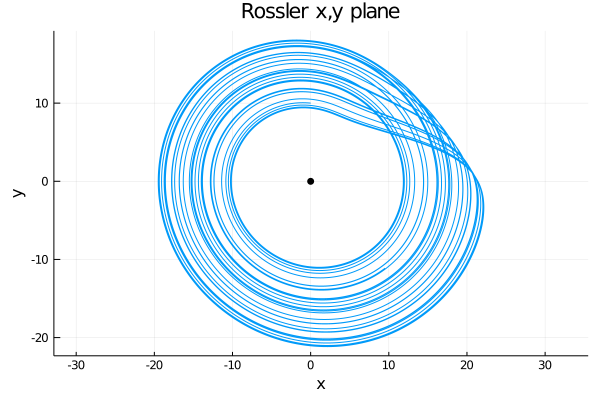

In [175]:
a,b,c = 0.1, 0.1, 14

x₀ = [0.0; 10.0; 0.01]
N = 20001
Δt = 0.01
t₀ = 0.0

(xstar0, xstar1) = rossler_eqbs(a,b,c)

f  = rossler_f(a,b,c)

t,x = rk4(f, x₀, Δt, N)

plot(x[:,1], x[:,2], label="")
scatter!([xstar0[1]], [xstar0[2]], markercolor=:black, label="")
plot!(xlabel="x",ylabel="y",aspect_ratio=:equal)
plot!(title="Rossler x,y plane")

## 2. Define a Poincare section, the x=0 plane

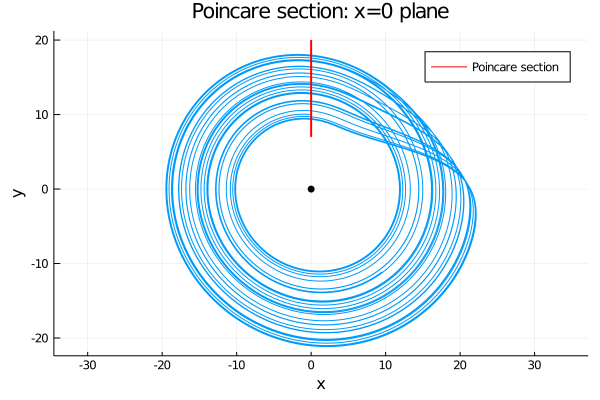

In [176]:
plot(x[:,1], x[:,2], label="")
scatter!([xstar0[1]], [xstar0[2]], markercolor=:black, label="")
plot!([0.0; 0.0], [7.0; 20.0], color=:red, width=2, label="Poincare section")
plot!(xlabel="x",ylabel="y",aspect_ratio=:equal)
plot!(title="Poincare section: x=0 plane")

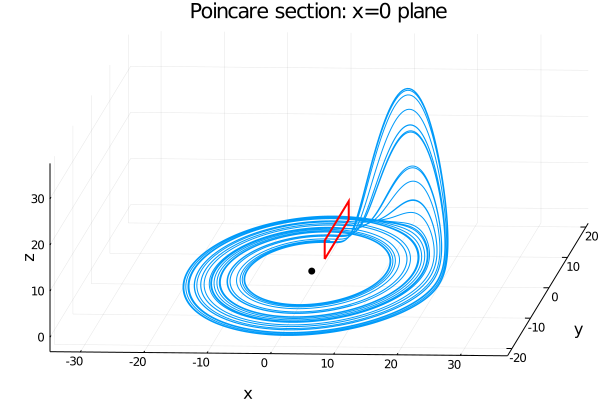

In [177]:
plot(x[:,1], x[:,2], x[:,3], label="")
scatter!([xstar0[1]], [xstar0[2]], [xstar0[3]], markercolor=:black, label="")
xpoinc = [0.0;  0.0;  0.0; 0.0; 0.0]
ypoinc = [7.0; 20.0; 20.0; 7.0; 7.0]
zpoinc = [-2.0;  -2.0;  2.0; 2.0; -2.0]
plot!(xpoinc, ypoinc, zpoinc, color=:red, width=2, label="")
plot!(xlabel="x",ylabel="y",zlabel="z")
plot!(camera=(10,50), aspect_ratio=:equal, legend=:topleft)
plot!(title="Poincare section: x=0 plane")

### 3,4. Write code to calculate Poincare intersections and Poincare map

In [178]:
using Polynomials

function rk4step(f, x, Δt)     
    s1 = f(x)
    s2 = f(x + Δt/2*s1)
    s3 = f(x + Δt/2*s2)
    s4 = f(x + Δt *s3)
    x + Δt/6*(s1 + 2s2 + 2s3 + s4) 
end

# From a point (x,y,z), integrate dx/dt = f(x) until it passes through the Poincare section (e.g. x=0)
# going in the positive/negative direction according to s = +/-1 

function rk4map(f, x; Δt=0.01, s=-1) 
   
    m = length(x)
    
    # initiate with five successive rk4steps (in order to do 4th-order interp later)
    # X[i,n] is ith coordinate of nth runge-kutta step
    X = zeros(m, 5)
    X[:,1] = copy(x)
    for n=1:4
        X[:,n+1] = rk4step(f, X[:,n], Δt)
    end

    p = 1
    # integrate until x crosses x[p]=0 plane, s= ±1, x[p] increasing/decreasing,
    # determined by x[2] and x[4] spanning the x[p]=0 plane
    count = 0
    while !(s*X[p,2] < 0.0 && s*X[p,4] > 0.0)
        X[:,1:4] .= X[:, 2:5]  # shift in time
        X[:,5] .= rk4step(f, X[:,4], Δt)
        count = count + 1
    end
    #@show count
    xnext = zeros(m)
    
     # Do polynomial interpolation to find x[2:end] values of x[1]=0 crossing
    for i=1:m
        polyfit = fit(X[p,:], X[i,:])
        xnext[i]= polyfit(0.0)
    end
    xnext[p] = 0.0
    xnext
end

rk4map (generic function with 1 method)

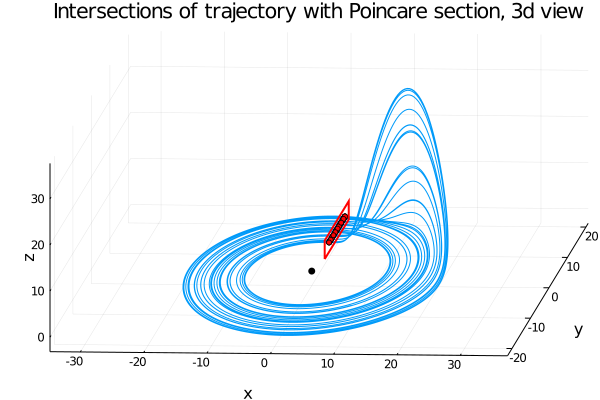

In [179]:
x₀ = [0.0; 13.0; 0.005]

x₀ .= rk4map(f,x₀)

N = 100
X = zeros(N,3)
X[1,:] .= x₀
for n=1:N-1
    X[n+1,:] .= rk4map(f, X[n,:])
end

plot(x[:,1], x[:,2], x[:,3], label="")
scatter!([xstar0[1]], [xstar0[2]], [xstar0[3]], markercolor=:black, label="")
scatter!(X[:,1], X[:,2], X[:,3], markersize=3, label="", color=:red)
plot!(xpoinc, ypoinc, zpoinc, color=:red, width=2, label="")
plot!(xlabel="x", ylabel="y", zlabel="z")
plot!(camera=(10,50), aspect_ratio=:equal)
plot!(title="Intersections of trajectory with Poincare section, 3d view")
#scatter(X[1:N-k,2], X[k+1:N,2])
#y = 12:22
#plot!(y,y,legend=:topleft)

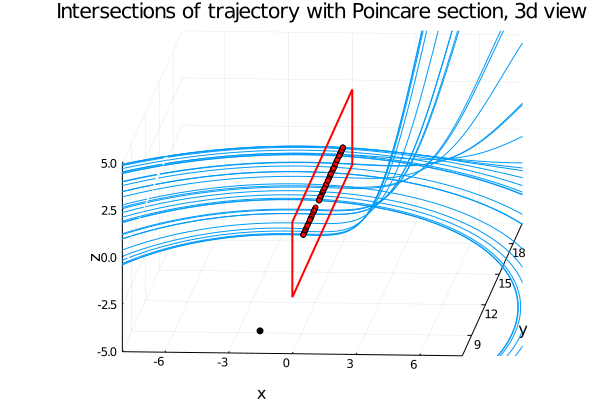

In [180]:
plot!(xlim=(-8,8),ylim=(7,20),zlim=(-5,5))

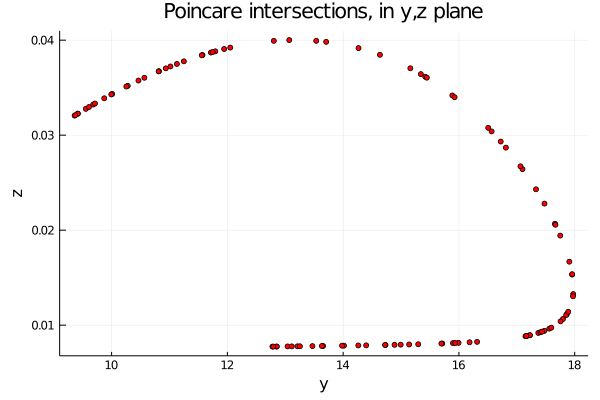

In [181]:
scatter(X[:,2], X[:,3], markersize=3, label="", color=:red)
plot!(xlabel="y", ylabel="z")
plot!(title="Poincare intersections, in y,z plane")

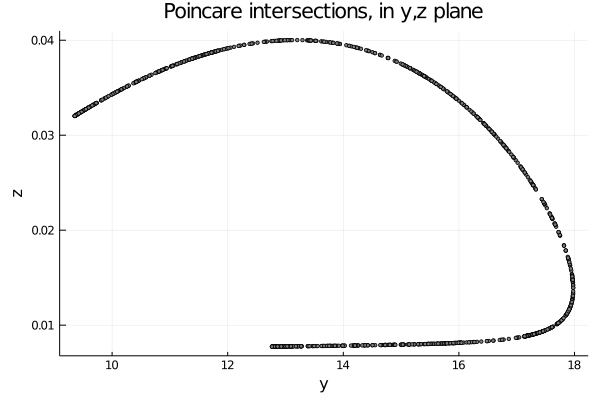

In [182]:
x₁= rk4map(f,x₀)

N = 1000
X = zeros(N,3)
X[1,:] .= x₁
for n=1:N-1
    X[n+1,:] .= rk4map(f, X[n,:])
end

X
k = 1
scatter(X[:,2], X[:,3], markersize=2, label="", color=:grey)
plot!(xlabel="y", ylabel="z")
plot!(title="Poincare intersections, in y,z plane")
#scatter(X[1:N-k,2], X[k+1:N,2])
#y = 12:22
#plot!(y,y,legend=:topleft)

### 5. Estimate a fixed point of the Poincare map using recurrence plots

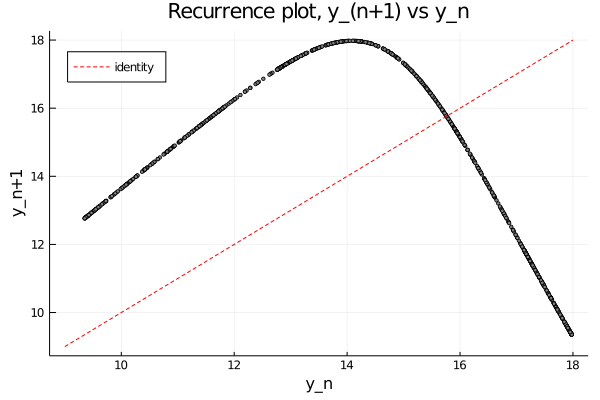

In [183]:
N = size(X,1)
k = 1
scatter(X[1:N-k,2], X[1+k:N,2], markersize=2, label="", color=:grey)
plot!([9, 18], [9, 18], color=:red, linestyle=:dash, label="identity")
plot!(xlabel="y_n", ylabel="y_n+$k", legend=:topleft)
plot!(title="Recurrence plot, y_(n+1) vs y_n")

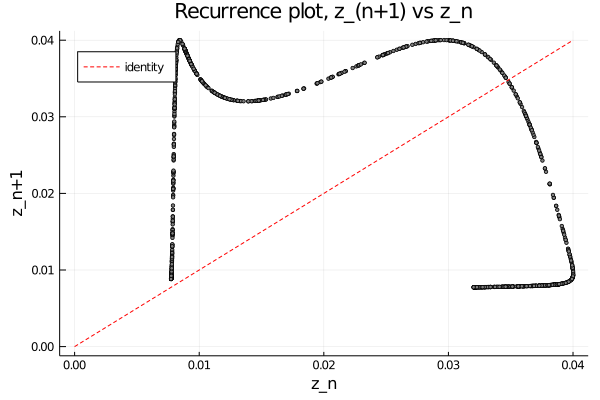

In [184]:
N = size(X,1)
k = 1
scatter(X[1:N-k,3], X[1+k:N,3], markersize=2, label="", color=:grey)
plot!([0, 0.04], [0, 0.04], color=:red, linestyle=:dash, label="identity")
plot!(xlabel="z_n", ylabel="z_n+$k", legend=:topleft)
plot!(title="Recurrence plot, z_(n+1) vs z_n")

In [185]:
xguess3d = [0; 16; 0.035]

3-element Array{Float64,1}:
  0.0  
 16.0  
  0.035

In [186]:
rk4map(f, xguess3d)

3-element Array{Float64,1}:
  0.0                
 15.143467911126143  
  0.03709290017147794

The guess nearly maps into itself under rk4 integration.

### 6. Find the fixed point using a nonlinear solver 
To use the nonlinear solver we have to re-express the map on the Poincare section as a function of two variables, $F:(yn,zn)→(yn+1,zn+1)$

In [187]:
function F(x)
    xyz = rk4map(f, [0.0; x[1]; x[2]])
    return [xyz[2]; xyz[3]]
end
xguess = [16; 0.035]
F(xguess)

2-element Array{Float64,1}:
 15.143467911126143  
  0.03709290017147794

In [188]:
using NLsolve

solution = fixedpoint(F, xguess)

Results of Nonlinear Solver Algorithm
 * Algorithm: Anderson m=2 beta=1 aa_start=1 droptol=0
 * Starting Point: [16.0, 0.035]
 * Zero: [15.7629, 0.0347487]
 * Inf-norm of residuals: 0.000000
 * Iterations: 7
 * Convergence: true
   * |x - x'| < 0.0e+00: false
   * |f(x)| < 1.0e-08: true
 * Function Calls (f): 7
 * Jacobian Calls (df/dx): 0

In [189]:
xstar = solution.zero
xnext = F(xstar)

@show xstar 
@show xnext
@show norm(xstar-xnext)

xstar = [15.7629, 0.0347487]
xnext = [15.7629, 0.0347487]
norm(xstar - xnext) = 3.6464323921434825e-9


3.6464323921434825e-9

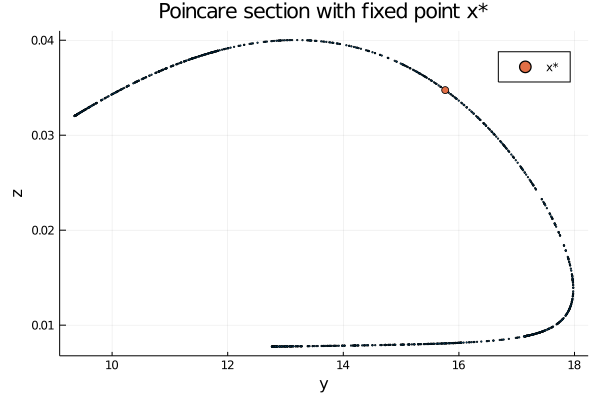

In [190]:
scatter(X[:,2], X[:,3], markersize=1, label="")
scatter!([xstar[1]], [xstar[2]], label="x*")
plot!(xlabel="y", ylabel="z")
plot!(title="Poincare section with fixed point x*")

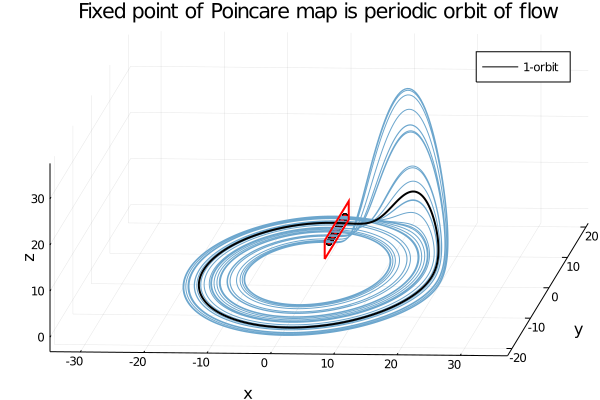

In [191]:
x₀ = [0.0; xstar[1]; xstar[2]]
Norb = Int64(round(6.4/Δt))

t,xorb = rk4(f, x₀, Δt, Norb)

scatter(X[:,1], X[:,2], X[:,3], markersize=3, label="", color=:red)
plot!(x[:,1], x[:,2], x[:,3], label="", color=:skyblue3)
plot!(xorb[:,1], xorb[:,2], xorb[:,3], color=:black, width=2, label="1-orbit")
plot!(xpoinc, ypoinc, zpoinc, color=:red, width=2, label="")
plot!(xlabel="x", ylabel="y", zlabel="z")
plot!(camera=(10,50), aspect_ratio=:equal)

plot!(title="Fixed point of Poincare map is periodic orbit of flow")

### Now, let's look for a period-2 orbit by finding fp's of the second iterate of the return map

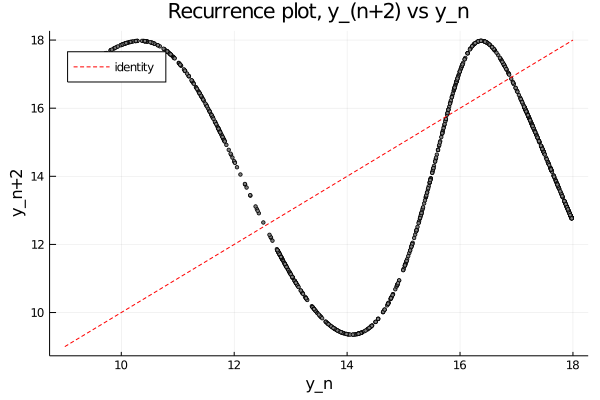

In [192]:
N = size(X,1)
k = 2
scatter(X[1:N-k,2], X[1+k:N,2], markersize=2, label="", color=:grey)
plot!([9, 18], [9, 18], color=:red, linestyle=:dash, label="identity")
plot!(xlabel="y_n", ylabel="y_n+$k", legend=:topleft)
plot!(title="Recurrence plot, y_(n+2) vs y_n")

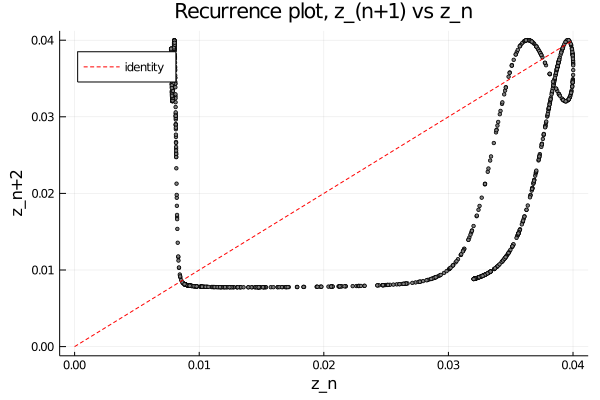

In [193]:
N = size(X,1)
k = 2
scatter(X[1:N-k,3], X[1+k:N,3], markersize=2, label="", color=:grey)
plot!([0, 0.04], [0, 0.04], color=:red, linestyle=:dash, label="identity")
plot!(xlabel="z_n", ylabel="z_n+$k", legend=:topleft)
plot!(title="Recurrence plot, z_(n+1) vs z_n")

In [194]:
xguess = [16.5; 0.01]

2-element Array{Float64,1}:
 16.5 
  0.01

In [195]:
function F2(x)
    return F(F(x))
end

F2 (generic function with 1 method)

In [196]:
@show F(xguess)
@show F2(xguess)

F(xguess) = [13.7248, 0.0398074]
F2(xguess) = [17.8968, 0.011503]


2-element Array{Float64,1}:
 17.896802872385972   
  0.011502985818053977

#### $F^{2}(xguess) \approx xguess$, so the guess is good.

In [197]:
solution = fixedpoint(F2, xguess)

Results of Nonlinear Solver Algorithm
 * Algorithm: Anderson m=2 beta=1 aa_start=1 droptol=0
 * Starting Point: [16.5, 0.01]
 * Zero: [16.8971, 0.00858048]
 * Inf-norm of residuals: 0.000000
 * Iterations: 8
 * Convergence: true
   * |x - x'| < 0.0e+00: false
   * |f(x)| < 1.0e-08: true
 * Function Calls (f): 8
 * Jacobian Calls (df/dx): 0

In [198]:
xstar_2orb = solution.zero
xback = F2(xstar_2orb)

@show xstar_2orb 
@show xback
@show norm(xstar_2orb-xback)

xstar_2orb = [16.8971, 0.00858048]
xback = [16.8971, 0.00858048]
norm(xstar_2orb - xback) = 4.231510194188676e-9


4.231510194188676e-9

### $xback = xstar_{2orb}$, so we have found the $2$-orbit!

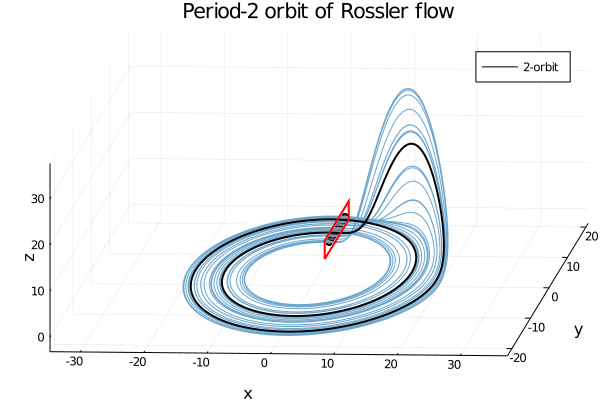

In [199]:
x₀ = [0.0; xstar_2orb[1]; xstar_2orb[2]]
Norb = Int64(round(13/Δt))

t,xorb = rk4(f, x₀, Δt, Norb)

scatter(X[:,1], X[:,2], X[:,3], markersize=3, label="", color=:red)
plot!(x[:,1], x[:,2], x[:,3], label="", color=:skyblue3)
plot!(xorb[:,1], xorb[:,2], xorb[:,3], color=:black, width=2, label="2-orbit")
plot!(xpoinc, ypoinc, zpoinc, color=:red, width=2, label="")
plot!(xlabel="x", ylabel="y", zlabel="z")
plot!(camera=(10,50), aspect_ratio=:equal)

plot!(title="Period-2 orbit of Rossler flow")

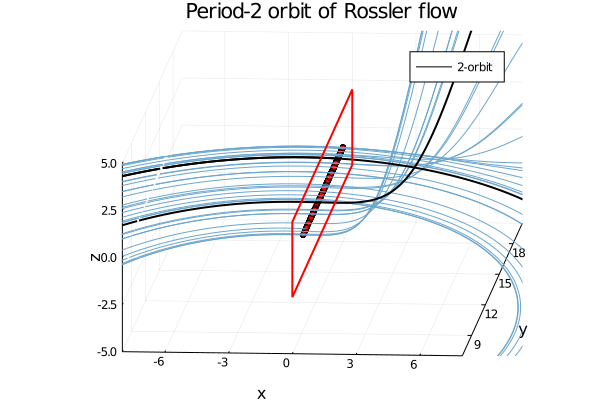

In [200]:
plot!(xlim=(-8,8),ylim=(7,20),zlim=(-5,5))

### Now, let's look for a period-3 orbit by finding fp's of the third iterate of the return map

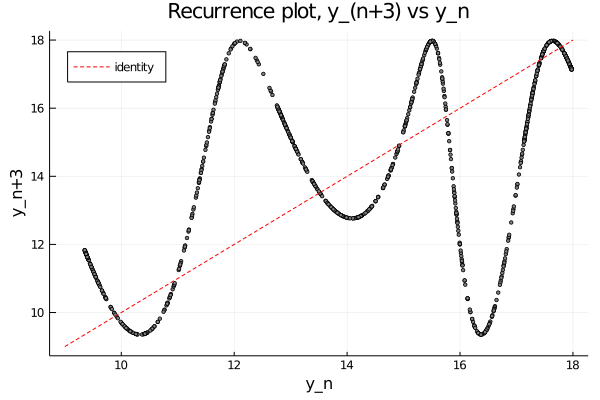

In [201]:
N = size(X,1)
k = 3
scatter(X[1:N-k,2], X[1+k:N,2], markersize=2, label="", color=:grey)
plot!([9, 18], [9, 18], color=:red, linestyle=:dash, label="identity")
plot!(xlabel="y_n", ylabel="y_n+$k", legend=:topleft)
plot!(title="Recurrence plot, y_(n+3) vs y_n")

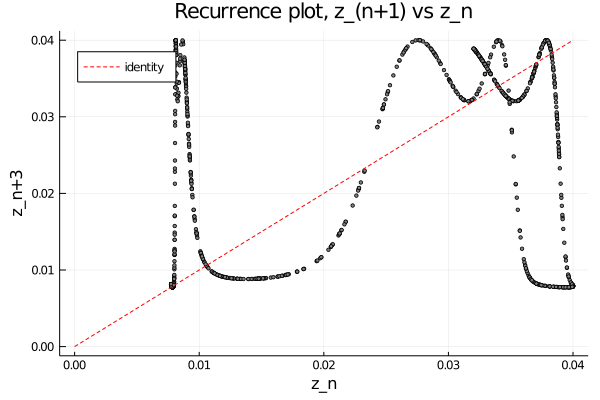

In [202]:
N = size(X,1)
k = 3
scatter(X[1:N-k,3], X[1+k:N,3], markersize=2, label="", color=:grey)
plot!([0, 0.04], [0, 0.04], color=:red, linestyle=:dash, label="identity")
plot!(xlabel="z_n", ylabel="z_n+$k", legend=:topleft)
plot!(title="Recurrence plot, z_(n+1) vs z_n")

In [203]:
function F3(x)
    return F(F2(x))
end

F3 (generic function with 1 method)

In [204]:
xguess = [17.5; 0.02]

2-element Array{Float64,1}:
 17.5 
  0.02

In [205]:
@show F(xguess)
@show F2(xguess)
@show F3(xguess)

F(xguess) = [10.7474, 0.0365429]
F2(xguess) = [14.6385, 0.00790347]
F3(xguess) = [17.7477, 0.0194711]


2-element Array{Float64,1}:
 17.747741996532344   
  0.019471132744178315

### $F^{3}(xguess) \approx xguess$, so the guess is good.

In [206]:
solution = fixedpoint(F3, xguess)

Results of Nonlinear Solver Algorithm
 * Algorithm: Anderson m=2 beta=1 aa_start=1 droptol=0
 * Starting Point: [17.5, 0.02]
 * Zero: [17.786, 0.0105773]
 * Inf-norm of residuals: 0.000000
 * Iterations: 12
 * Convergence: true
   * |x - x'| < 0.0e+00: false
   * |f(x)| < 1.0e-08: true
 * Function Calls (f): 12
 * Jacobian Calls (df/dx): 0

In [207]:
xstar_3orb = solution.zero
xback = F3(xstar_3orb)

@show xstar_3orb 
@show xback
@show norm(xstar_3orb-xback)

xstar_3orb = [17.786, 0.0105773]
xback = [17.786, 0.0105773]
norm(xstar_3orb - xback) = 7.983823407985534e-11


7.983823407985534e-11

### $xback = xstar_{3orb}$, so we have found the $3$-orbit!

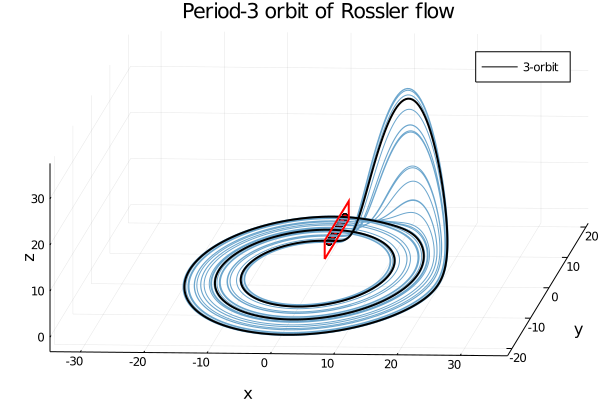

In [208]:
x₀ = [0.0; xstar_3orb[1]; xstar_3orb[2]]
Norb = Int64(round(18.5/Δt))

t,xorb = rk4(f, x₀, Δt, Norb)

scatter(X[:,1], X[:,2], X[:,3], markersize=3, label="", color=:red)
plot!(x[:,1], x[:,2], x[:,3], label="", color=:skyblue3)
plot!(xorb[:,1], xorb[:,2], xorb[:,3], color=:black, width=2, label="3-orbit")
plot!(xpoinc, ypoinc, zpoinc, color=:red, width=2, label="")
plot!(xlabel="x", ylabel="y", zlabel="z")
plot!(camera=(10,50), aspect_ratio=:equal)

plot!(title="Period-3 orbit of Rossler flow")

### Let's find the other 3-orbit

In [209]:
xguess = [15; 0.01]

2-element Array{Float64,1}:
 15.0 
  0.01

In [210]:
@show F(xguess)
@show F2(xguess)
@show F3(xguess)

F(xguess) = [17.3223, 0.02439]
F2(xguess) = [11.2747, 0.0378287]
F3(xguess) = [15.3315, 0.0079969]


2-element Array{Float64,1}:
 15.331545680777944   
  0.007996904384054575

#### $F^{3}(xguess) \approx xguess$, so the guess is good.

In [211]:
solution = fixedpoint(F3, xguess)

Results of Nonlinear Solver Algorithm
 * Algorithm: Anderson m=2 beta=1 aa_start=1 droptol=0
 * Starting Point: [15.0, 0.01]
 * Zero: [14.9269, 0.00793816]
 * Inf-norm of residuals: 0.000000
 * Iterations: 7
 * Convergence: true
   * |x - x'| < 0.0e+00: false
   * |f(x)| < 1.0e-08: true
 * Function Calls (f): 7
 * Jacobian Calls (df/dx): 0

In [212]:
xstar_3orb_b = solution.zero
xback = F3(xstar_3orb_b)

@show F(xstar_3orb_b)
@show F2(xstar_3orb_b)
@show xstar_3orb_b 
@show xback
@show norm(xstar_3orb_b-xback)

F(xstar_3orb_b) = [17.4263, 0.0233467]
F2(xstar_3orb_b) = [10.9657, 0.0371063]
xstar_3orb_b = [14.9269, 0.00793816]
xback = [14.9269, 0.00793816]
norm(xstar_3orb_b - xback) = 4.410987558991079e-9


4.410987558991079e-9

### $xback = xstar_{3orb}$, so we have found the other $3$-orbit!

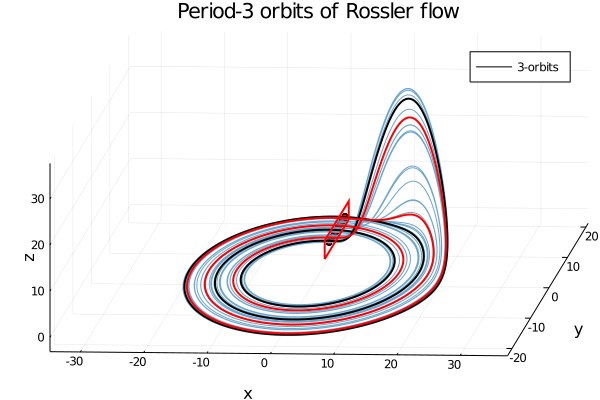

In [213]:
x0 = [0.0; xstar_3orb[1]; xstar_3orb[2]]
x0_b = [0.0; xstar_3orb_b[1]; xstar_3orb_b[2]]

Norb = Int64(round(18.5/Δt))

t,xorb = rk4(f, x0, Δt, Norb)
t,xorb_b = rk4(f, x0_b, Δt, Norb)

scatter(X[:,1], X[:,2], X[:,3], markersize=3, label="", color=:red)
plot!(x[:,1], x[:,2], x[:,3], label="", color=:skyblue3)
plot!(xorb[:,1], xorb[:,2], xorb[:,3], color=:black, width=2, label="3-orbits")
plot!(xorb_b[:,1], xorb_b[:,2], xorb_b[:,3], color=:red, width=2, label="")

plot!(xpoinc, ypoinc, zpoinc, color=:red, width=2, label="")
plot!(xlabel="x", ylabel="y", zlabel="z")
plot!(camera=(10,50), aspect_ratio=:equal)

plot!(title="Period-3 orbits of Rossler flow")

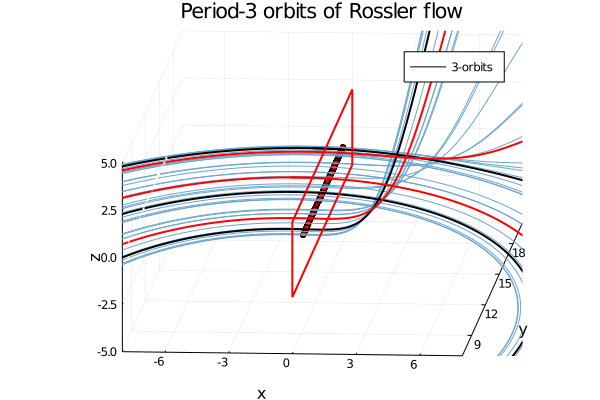

In [214]:
plot!(xlim=(-8,8),ylim=(7,20),zlim=(-5,5))

### In the zoomed in plot, we can see 3-orbits cutting the Poincare section thrice (each). 